# 1. Import Library

In [1]:
import os

import tensorflow as tf
import keras 
from keras import layers, models
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from keras.api.applications import EfficientNetB0
from pathlib import Path

In [2]:
tf.config.list_physical_devices('GPU')
tf.test.is_gpu_available()

Instructions for updating:
Use `tf.config.list_physical_devices('GPU')` instead.


False

# 2. Load data using `keras.preprocessing.image_dataset_from_directory`

In [3]:
IMAGE_SIZE = 224
BATCH_SIZE = 32
CPU_FLOW = os.cpu_count() 

In [4]:
data_dir ='../Dataset/AppleDisease'
train_dir = data_dir + "/train"
val_dir = data_dir + "/val"
test_dir = data_dir + "/test"

In [5]:
train_dataset = keras.preprocessing.image_dataset_from_directory(directory=train_dir, 
                                                           shuffle=True, 
                                                           image_size=(IMAGE_SIZE, IMAGE_SIZE),
                                                           batch_size=BATCH_SIZE,
                                                            label_mode="categorical")
val_dataset = keras.preprocessing.image_dataset_from_directory(directory=val_dir, 
                                                           shuffle=True, 
                                                           image_size=(IMAGE_SIZE, IMAGE_SIZE),
                                                           batch_size=BATCH_SIZE, label_mode="categorical")
test_dataset = keras.preprocessing.image_dataset_from_directory(directory=test_dir, 
                                                           shuffle=True, 
                                                           image_size=(IMAGE_SIZE, IMAGE_SIZE),
                                                           batch_size=BATCH_SIZE, label_mode="categorical")

Found 1146 files belonging to 5 classes.
Found 161 files belonging to 5 classes.
Found 334 files belonging to 5 classes.


In [6]:
class_names = train_dataset.class_names

In [7]:
print(class_names)

['alternaria_leaf_spot', 'brown_spot', 'gray_spot', 'healthy_leaf', 'rust']


In [8]:
for img_batch, label_batch in train_dataset.take(1):
    print(img_batch.shape)
    print(label_batch.numpy())

(32, 224, 224, 3)
[[0. 1. 0. 0. 0.]
 [0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 1.]
 [0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0.]
 [0. 0. 0. 0. 1.]
 [0. 0. 0. 1. 0.]
 [0. 0. 0. 1. 0.]
 [1. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0.]
 [0. 0. 1. 0. 0.]
 [0. 0. 1. 0. 0.]
 [0. 0. 0. 1. 0.]
 [0. 0. 1. 0. 0.]
 [0. 1. 0. 0. 0.]
 [0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1.]
 [0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0.]
 [0. 1. 0. 0. 0.]
 [0. 0. 0. 0. 1.]
 [1. 0. 0. 0. 0.]
 [0. 0. 1. 0. 0.]
 [0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0.]
 [0. 0. 0. 1. 0.]]


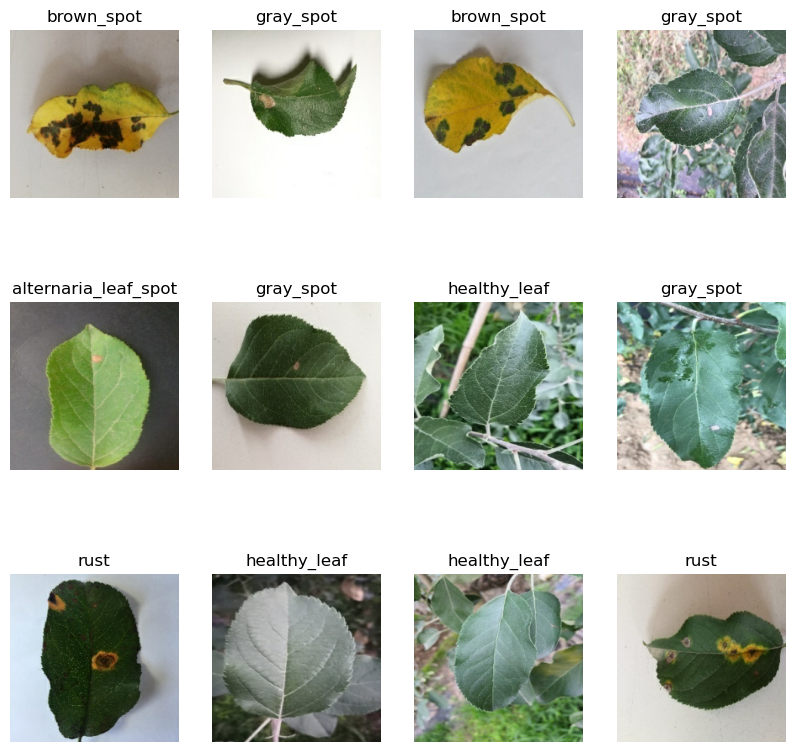

In [9]:
plt.figure(figsize=(10, 10))
for img_batch, label_batch in train_dataset.take(1):
    for i in range(12):
        plt.subplot(3, 4, i+1)
        plt.imshow(img_batch[i].numpy().astype('uint8'))
        label = tf.argmax(label_batch[i]).numpy()
        
        plt.title(class_names[int(label)])
        plt.axis('off')

In [26]:
data_augmentation = models.Sequential([
    layers.RandomRotation(factor=0.15),
    layers.RandomTranslation(height_factor=0.1, width_factor=0.1),
    layers.RandomFlip(),
    layers.RandomContrast(factor=0.1),
])
train_data_augmentation = test_dataset.map(
    lambda x, y : (data_augmentation(x, training=True), y)).prefetch(buffer_size=tf.data.AUTOTUNE)

In [27]:
len(train_dataset)

36

# 4. Cache, Shuffle, and Prefetch the Dataset

In [28]:
train_dataset.cache().shuffle(32).prefetch(buffer_size=tf.data.AUTOTUNE)
val_dataset.cache().shuffle(32).prefetch(buffer_size=tf.data.AUTOTUNE)

<_PrefetchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 5), dtype=tf.float32, name=None))>

# 5. Model

## 5.1 Transfer Learning with EfficientNetB0

In [ ]:
backbone = EfficientNetB0(input_shape=(IMAGE_SIZE,IMAGE_SIZE, 3),
                                               include_top=False,
                                               weights="imagenet")

In [ ]:
_input = layers.Input(shape=(IMAGE_SIZE,IMAGE_SIZE, 3), name="Input")
x = backbone(_input)
x = layers.GlobalAveragePooling2D()(x)
x= layers.BatchNormalization()(x)
x= layers.Dense(512, activation=tf.nn.silu, 
                         kernel_regularizer = keras.regularizers.l2(1e-5))(x)
x= layers.Dropout(0.2)(x)
x= layers.Dense(256, activation=tf.nn.silu, 
                         kernel_regularizer = keras.regularizers.l2(1e-5))(x)
x= layers.Dropout(0.2)(x)
x = layers.Dense(len(class_names), activation="softmax", name="classification")(x)

model = keras.Model(inputs=[_input], outputs =[x], name="PotatoDisease_classification")

In [13]:
model.summary()

Model: "AppleDisease_classification"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ Input (InputLayer)              │ (None, 224, 224, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ efficientnetb0 (Functional)     │ (None, 7, 7, 1280)     │     4,049,571 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_2      │ (None, 1280)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 1280)           │         5,120 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 512)            │       655,872 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_4 (Dropout)             │ (None, 512)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 256)            │       131,328 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_5 (Dropout)             │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ classification (Dense)          │ (None, 5)              │         1,285 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 4,843,178 (18.48 MB)

 Trainable params: 4,798,593 (18.31 MB)

 Non-trainable params: 44,583 (174.16 KB)

 Optimizer params: 2 (12.00 B)

In [14]:
model.compile(
    loss=keras.losses.CategoricalCrossentropy(),
    optimizer=keras.optimizers.Adam(learning_rate=0.001),
    metrics=['accuracy']
)

In [20]:
tf.config.run_functions_eagerly(False)
history = model.fit(train_dataset, epochs=100, validation_data=val_dataset)

NameError: name 'train_dataset' is not defined

In [ ]:
scores = model.evaluate(test_dataset)
print(scores)

# 6. Plotting the Accuracy and Loss Curves

In [134]:
history =history.history

In [135]:
train_acc = history['accuracy']
val_acc = history['val_accuracy']
train_loss = history['loss']
val_loss = history['val_loss']

In [136]:
# Setup for plotting
labels = ['Training', 'Validation']
data_plot = [{
    'title' : 'Accuracy',
    'train_data' : train_acc,
    'val_data' : val_acc
    
}, {
    'title' : 'Loss',
    'train_data' : train_loss,
    'val_data' : val_loss
    
}
]

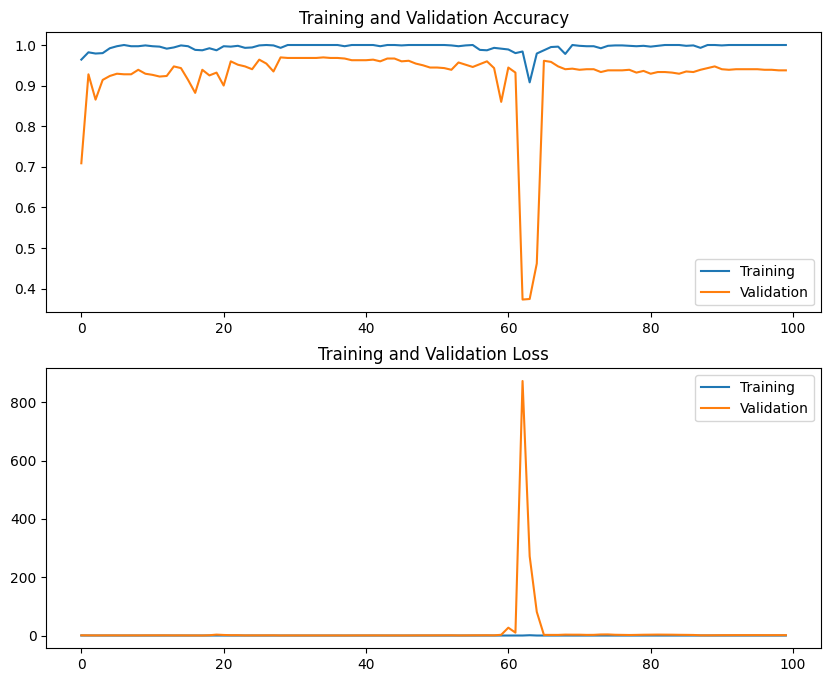

In [137]:
EPOCHS = 100
plt.figure(figsize=(10, 8))
for i in range(len(data_plot)):
    plt.subplot(2, 1, i+1)
    plt.plot(range(EPOCHS), data_plot[i]['train_data'], label=labels[0])
    plt.plot(range(EPOCHS), data_plot[i]['val_data'], label=labels[1])
    plt.title(f'Training and Validation {data_plot[i]["title"]}')
    plt.legend( loc='lower right' if i == 0 else 'upper right')
    

# 7. Run prediction on a sample image

First image to predict
actual label: rust
predicted label: gray_spot


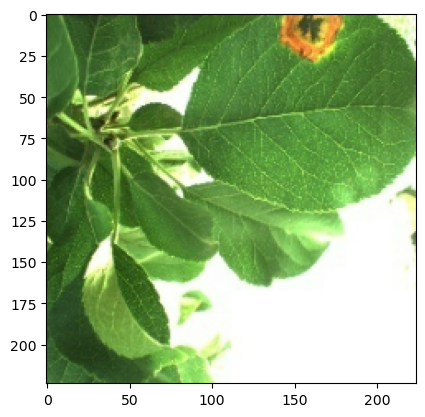

In [19]:
for img_batch, label_batch in test_dataset.take(1):
    img = img_batch[0].numpy().astype('uint8')
    label = tf.argmax(label_batch[i]).numpy()
        
    print("First image to predict")
    plt.imshow(img)
    print("actual label:",class_names[int(label)])
    
    batch_prediction = model.predict(img_batch)
    print("predicted label:",class_names[np.argmax(batch_prediction[0])])

# 8. Write function for inference

In [27]:
def predict_disease(mode :models.Sequential, img):
    img_arr = keras.preprocessing.image.img_to_array(img)
    img_arr = tf.expand_dims(img, 0)

    prediction = model.predict(img_arr, verbose=False)
    pred_class = class_names[np.argmax(prediction[0])]
    
    confidence = round(100*(np.max(prediction[0])), 2)
    
    return pred_class, confidence

## 8.1 Now run inference on few sample image

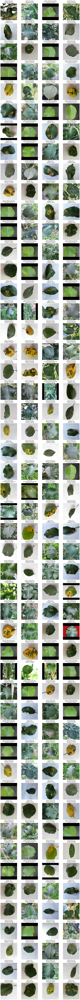

In [28]:
def inference_predict(root_dir, model, limited=200):
    path_imgs = [str(x) for x in Path(root_dir).glob("*/*.jpg")]
    np.random.shuffle(path_imgs)
    path_imgs = path_imgs[:limited]
    len_path = len(path_imgs)
    col = 4
    row = len_path // col +1
    plt.figure(figsize=(20, row*5))
    for i, path in enumerate(path_imgs):
        plt.subplot(row, col, i+1)
        img_raw = tf.io.read_file(path)
        img_tensor = tf.image.decode_image(img_raw)

        img_tensor = tf.image.resize(img_tensor, [224, 224]).numpy()

        plt.imshow(img_tensor.astype("uint8"))

        pred_class, confidence = predict_disease(model, img_tensor)
        actual_class = path.split("\\")[-2]

        plt.title(f"Actual: {actual_class},\n Predicted: {pred_class}.\n Confidence: {confidence}%")
        plt.axis('off')
inference_predict(test_dir, model)

# 9.Saving the Model 

In [141]:
model.name

'PeachDisease_classification'

In [142]:
model.export(f"./SavedModel/{model.name}")
model.save(f"./Model/{model.name}.h5")

Saved artifact at './Model/PeachDisease_classification'. The following endpoints are available:

* Endpoint 'serve'
  args_0 (POSITIONAL_ONLY): TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name='Input')
Output Type:
  TensorSpec(shape=(None, 2), dtype=tf.float32, name=None)
Captures:
  136163396006512: TensorSpec(shape=(1, 1, 1, 3), dtype=tf.float32, name=None)
  136165859947824: TensorSpec(shape=(1, 1, 1, 3), dtype=tf.float32, name=None)
  136163394704432: TensorSpec(shape=(), dtype=tf.resource, name=None)
  136163394701088: TensorSpec(shape=(), dtype=tf.resource, name=None)
  136163394711296: TensorSpec(shape=(), dtype=tf.resource, name=None)
  136163394704960: TensorSpec(shape=(), dtype=tf.resource, name=None)
  136163394706192: TensorSpec(shape=(), dtype=tf.resource, name=None)
  136163394818064: TensorSpec(shape=(), dtype=tf.resource, name=None)
  136163394816304: TensorSpec(shape=(), dtype=tf.resource, name=None)
  136163394822816: TensorSpec(shape=(), dtype=tf.resourc